# Identifying Small Body Sphericity and Correlating Factors
- **Team Leader:** Jalen Perkins (Jalen-Perkins)
- **Other Group Members:** Madeline Pastuszek (madelinepast), Nathan Bigelow (Nbig17)

### In order to learn more about the small bodies that populate our solar system, we took data from an existing database called the [3D Asteroid Catalogue](https://3d-asteroids.space/) and created functions to read, model, and calculate a factor of geometry: sphericity.

### Through this project, we hope to discover how the object's relative sphericity may relate to other influencing factors, such as size, location, orbital characteristics, and other parameters.

### For the purposes of this presentation, we will be displaying our process with the 433 Eros Asteroid and the 16 Psyche Asteroid. Both of these objects are located near or beyond Mars in the main asteroid belt and are known for being rather large objects compared to other small bodies in our solar system. As well, both of these object files were obtained through the Catalogue.

# Reading Data

### Our first step was to write a function that allowed us to read the data we got from the Catalogue. This function reads the raw data and returns the data as the following organized dataframe with seperated vertices and faces for easier plotting and understanding. 

In [1]:
from Data_functions import getData # import our reading data function

## 433 Eros

In [2]:
eros_433 = getData('../data/obj/Eros Gaskell 50k poly.obj') # read eros data and store as a variable
eros_433 # display reorganized eros data

(             x        y        z
 0     -9.35813  3.76523  3.80820
 1     -9.11601  3.81266  3.85523
 2     -8.87554  3.86414  3.90521
 3     -8.63695  3.91930  3.95768
 4     -8.39712  3.97065  4.00731
 ...        ...      ...      ...
 25345  5.16697  3.83943 -3.18429
 25346  5.36410  3.71767 -3.08140
 25347  5.56375  3.59955 -2.97935
 25348  5.77286  3.49709 -2.88132
 25349  5.98246  3.39538 -2.78347
 
 [25350 rows x 3 columns],
              x        y        z
 0          1.0     67.0      2.0
 1          1.0     66.0     67.0
 2         66.0    132.0     67.0
 3         66.0    131.0    132.0
 4        131.0    197.0    132.0
 ...        ...      ...      ...
 49147  25154.0  25219.0  21123.0
 49148  25219.0  21124.0  21123.0
 49149  25219.0  25284.0  21124.0
 49150  25284.0  16836.0  21124.0
 49151  25284.0  16837.0  16836.0
 
 [49152 rows x 3 columns])

## 16 Psyche

In [3]:
psy_16 = getData('../data/obj/Psyche Hanuš.obj') # read psyche data and store as a variable
psy_16 # display reorganized psyche data

(             x          y         z
 0     0.264157   5.740792  82.35036
 1    20.691957   5.740792  82.34746
 2     0.264157  26.494492  76.53256
 3   -20.228443   5.740792  80.02926
 4     0.264157 -14.626408  84.26186
 ..         ...        ...       ...
 397  20.154757   5.740792 -76.29494
 398   0.264157  27.546892 -83.11054
 399 -19.573043   5.740792 -75.66074
 400   0.264157 -13.268708 -71.05814
 401   0.264157   5.740792 -77.34204
 
 [402 rows x 3 columns],
          x      y      z
 0      1.0    2.0    3.0
 1      1.0    3.0    4.0
 2      1.0    4.0    5.0
 3      1.0    5.0    2.0
 4      2.0    6.0    7.0
 ..     ...    ...    ...
 795  398.0  390.0  397.0
 796  402.0  399.0  398.0
 797  402.0  400.0  399.0
 798  402.0  401.0  400.0
 799  402.0  398.0  401.0
 
 [800 rows x 3 columns])

# Plotting Small Bodies

### Next, we worked on creating a function that would plot the asteroid from just the data we'd read. This function creates a 3-D, interactive plot from the previous organized data with unique titles and axes. These plots also display the calculated center of mass, which will be important for later sphericity calculations.

In [4]:
from plots import makePlot # import our plotting function
%matplotlib widget 

## 433 Eros

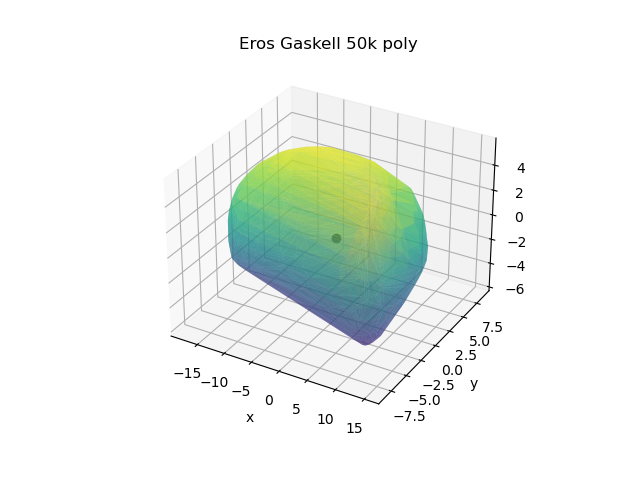

In [5]:
eros_plot = makePlot('../data/obj/Eros Gaskell 50k poly.obj') # create eros plot

## 16 Psyche

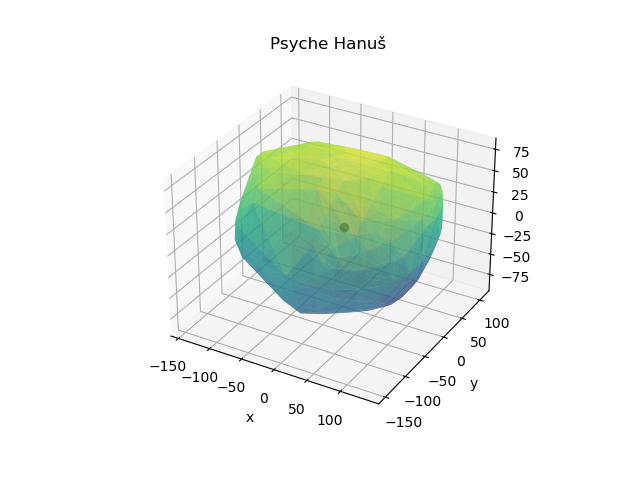

In [6]:
psy_plot = makePlot('../data/obj/Psyche Hanuš.obj') # create psyche plot

# Calculating Vectors

In [7]:
from vector_functions import getNormal, plotNormals

## 433 Eros

In [8]:
norm = getNormal('../data/obj/Eros Gaskell 50k poly.obj')
norm

[array([[ 6.01857300e-02,  1.18844855e+02,  4.23952433e+02],
        [-4.81714131e+01,  1.19221848e+02,  4.25297273e+02],
        [-4.72743079e+01,  3.91716049e+01,  4.17376883e+02],
        ...,
        [-3.66625959e+01, -1.14430888e+02, -4.32571967e+02],
        [-3.19606723e+01, -1.24654981e+02, -3.77095253e+02],
        [ 1.99048475e+01, -1.24990541e+02, -3.78110361e+02]])]

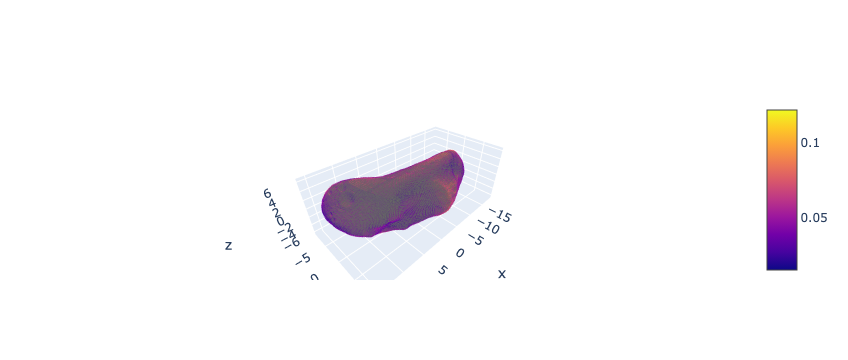

In [9]:
plotNormals('../data/obj/Eros Gaskell 50k poly.obj')

## 16 Psyche

In [10]:
norm = getNormal('../data/obj/Psyche Hanuš.obj')
norm

[array([[ 6.01857300e-02,  1.18844855e+02,  4.23952433e+02],
        [-4.81714131e+01,  1.19221848e+02,  4.25297273e+02],
        [-4.72743079e+01,  3.91716049e+01,  4.17376883e+02],
        ...,
        [-3.66625959e+01, -1.14430888e+02, -4.32571967e+02],
        [-3.19606723e+01, -1.24654981e+02, -3.77095253e+02],
        [ 1.99048475e+01, -1.24990541e+02, -3.78110361e+02]])]

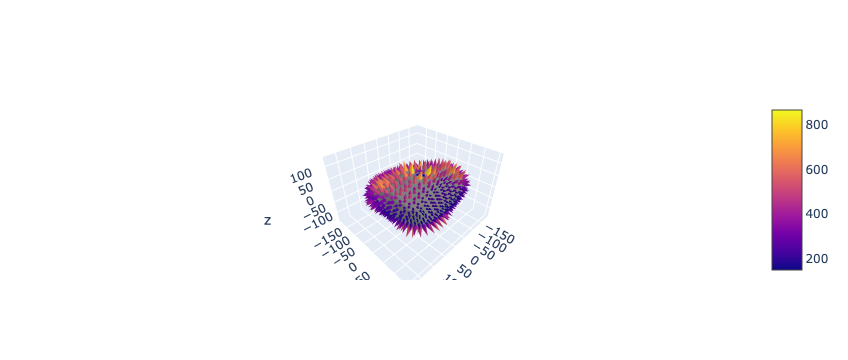

In [11]:
plotNormals('../data/obj/Psyche Hanuš.obj')

# Plotting Sphericity

In [1]:
from vector_functions import plot_sphere

In [2]:
path_eros = '../data/obj/Eros Gaskell 50k poly.obj'
path_psyche = '../data/obj/Psyche Hanuš.obj'

## 433 Eros

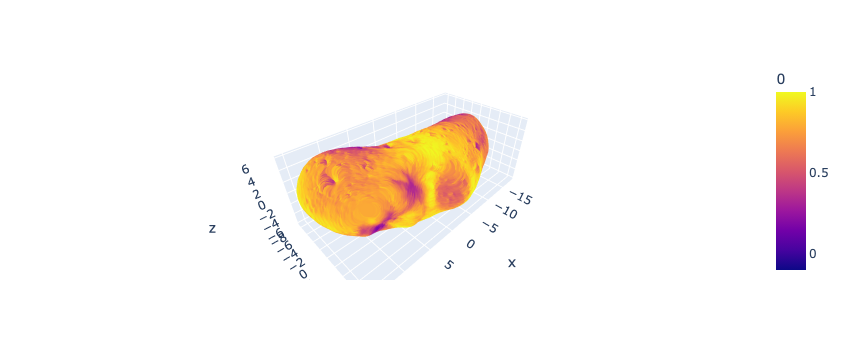

In [3]:
plot_sphere(path_eros)

## 16 Psyche

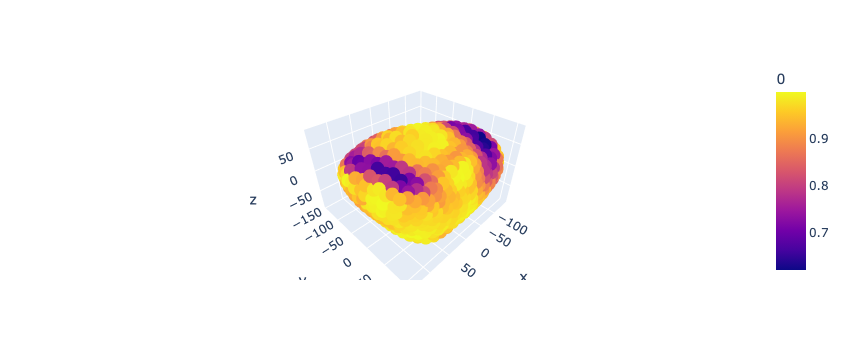

In [4]:
plot_sphere(path_psyche)

# Conclusions

In [5]:
from vector_functions import avg_spherisity

In [6]:
print(f'Spherisity of Eros: {avg_spherisity(path_eros)}')
print(f'Spherisity of Psyche: {avg_spherisity(path_psyche)}')

Spherisity of Eros: 0    0.678159
dtype: float64
Spherisity of Psyche: 0    0.883242
dtype: float64
